In [1]:
import os
import numpy as np
import pandas as pd
import geopandas as gpd

import matplotlib.pyplot as plt

DATA_PROCESSED = os.path.join("..", "data", "processed")
CRS_NYC = 2263

In [2]:
nta_viz = pd.read_parquet(os.path.join(DATA_PROCESSED, "nta_viz.parquet"))
bld_viz = gpd.read_parquet(os.path.join(DATA_PROCESSED, "buildings_viz.parquet"))

print("nta_viz:", nta_viz.shape)
print("bld_viz:", bld_viz.shape, "crs:", bld_viz.crs)

nta_viz.head()

nta_viz: (262, 21)
bld_viz: (1082999, 11) crs: {"$schema": "https://proj.org/schemas/v0.7/projjson.schema.json", "type": "ProjectedCRS", "name": "NAD83 / New York Long Island (ftUS)", "base_crs": {"name": "NAD83", "datum": {"type": "GeodeticReferenceFrame", "name": "North American Datum 1983", "ellipsoid": {"name": "GRS 1980", "semi_major_axis": 6378137, "inverse_flattening": 298.257222101}}, "coordinate_system": {"subtype": "ellipsoidal", "axis": [{"name": "Geodetic latitude", "abbreviation": "Lat", "direction": "north", "unit": "degree"}, {"name": "Geodetic longitude", "abbreviation": "Lon", "direction": "east", "unit": "degree"}]}, "id": {"authority": "EPSG", "code": 4269}}, "conversion": {"name": "SPCS83 New York Long Island zone (US survey foot)", "method": {"name": "Lambert Conic Conformal (2SP)", "id": {"authority": "EPSG", "code": 9802}}, "parameters": [{"name": "Latitude of false origin", "value": 40.1666666666667, "unit": "degree", "id": {"authority": "EPSG", "code": 8821}}, 

,NTACode,NTAName,boroname,geometry,nta_area_sqft,nta_area_sqmi,building_count,total_footprint_sqft,median_building_sqft,built_area_ratio,...,built_sqft_per_sqmi,pct_buildings_flooded,pct_footprint_flooded,flooded_building_count,flooded_footprint_sqft,pct_bld_flooded_last10,pct_sqft_flooded_last10,pct_bld_flooded_last20,pct_sqft_flooded_last20,risk_score
0,BK0101,Greenpoint,Brooklyn,b'\x01\x03\x00\x00\x00\x01\x00\x00\x00\xdb\x01...,3.532174e+07,1.266993,5147.0,1.340080e+07,1248.021588,0.379392,...,1.057685e+07,0.033813,0.050902,174.0,681959.369194,0.030120,0.074803,0.054054,0.073262,0.019312
1,BK0102,Williamsburg,Brooklyn,b'\x01\x03\x00\x00\x00\x01\x00\x00\x00\x16\x01...,2.885280e+07,1.034952,3646.0,1.037733e+07,1334.824761,0.359665,...,1.002687e+07,0.029073,0.081145,106.0,842069.864516,0.088785,0.140213,0.087912,0.163995,0.029185
2,BK0103,South Williamsburg,Brooklyn,b'\x01\x03\x00\x00\x00\x01\x00\x00\x00f\x00\x0...,1.520896e+07,0.545546,2294.0,5.418461e+06,1408.694795,0.356268,...,9.932172e+06,0.096338,0.166246,221.0,900796.021973,0.380435,0.599015,0.377778,0.541016,0.059228
3,BK0104,East Williamsburg,Brooklyn,b'\x01\x03\x00\x00\x00\x01\x00\x00\x00\xa8\x02...,5.226747e+07,1.874838,4939.0,1.745002e+07,1354.539352,0.333860,...,9.307485e+06,0.018436,0.042365,91.0,736213.686240,0.033149,0.161547,0.017817,0.072092,0.014144
4,BK0201,Brooklyn Heights,Brooklyn,b'\x01\x03\x00\x00\x00\x01\x00\x00\x00~\x00\x0...,9.982088e+06,0.358058,1492.0,3.913004e+06,1358.771123,0.392003,...,1.092840e+07,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000


In [3]:
bld_viz["is_flooded"].mean()
bld_viz["built_last_10yrs"].mean()
bld_viz["built_last_20yrs"].mean()


np.float64(0.04121527217887572)

In [4]:
nta_viz = gpd.GeoDataFrame(
    nta_viz,
    geometry=gpd.GeoSeries.from_wkb(nta_viz["geometry"]),
    crs=CRS_NYC
)

In [5]:
print("bld_viz:", nta_viz.shape, "crs:", nta_viz.crs)

bld_viz: (262, 21) crs: EPSG:2263


In [6]:
# nta review
print(nta_viz.geometry.geom_type.value_counts())

# buildings review
print(bld_viz.geometry.geom_type.value_counts())

# flood rate review
print(bld_viz["is_flooded"].mean())


Polygon         228
MultiPolygon     34
Name: count, dtype: int64
Polygon    1082999
Name: count, dtype: int64
0.019865207631770666


In [7]:
def plot_choropleth(gdf, col, title, cmap="viridis", k=0.02):
    fig, ax = plt.subplots(1, 1, figsize=(12, 12))
    gdf.plot(
        column=col,
        ax=ax,
        legend=True,
        cmap=cmap,
        missing_kwds={"color":"lightgrey", "label":"Missing"}
    )
    ax.set_title(title)
    ax.axis("off")
    plt.show()

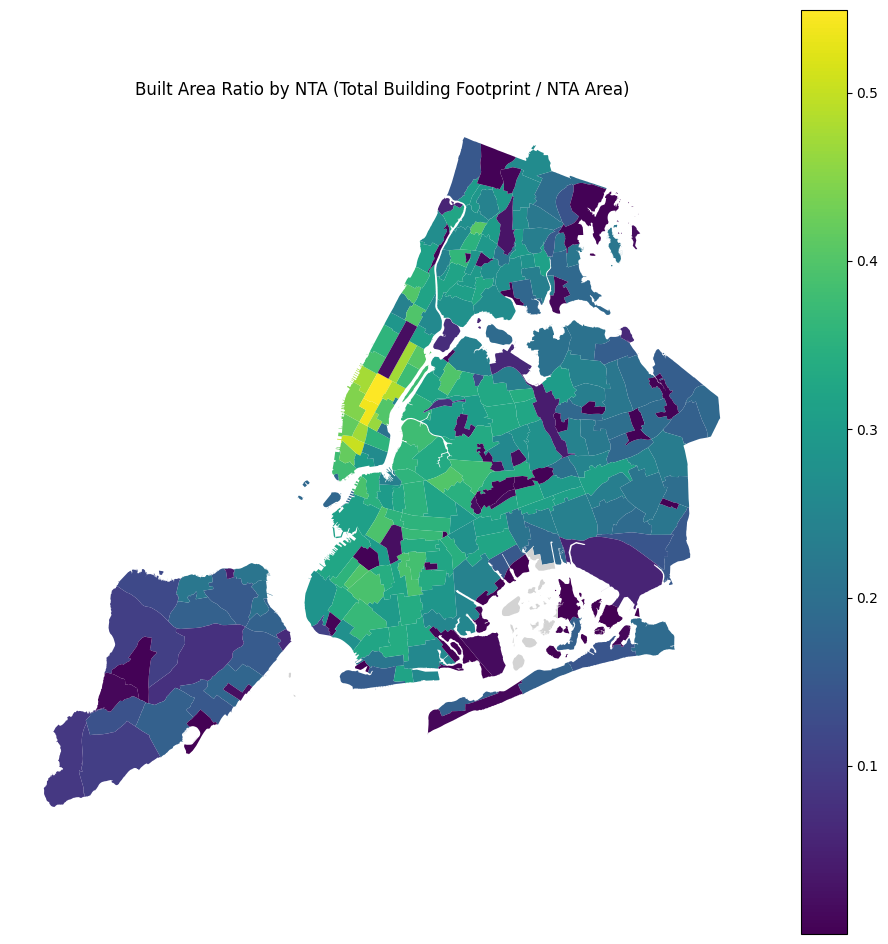

In [8]:
plot_choropleth(
    nta_viz,
    "built_area_ratio",
    "Built Area Ratio by NTA (Total Building Footprint / NTA Area)"
)

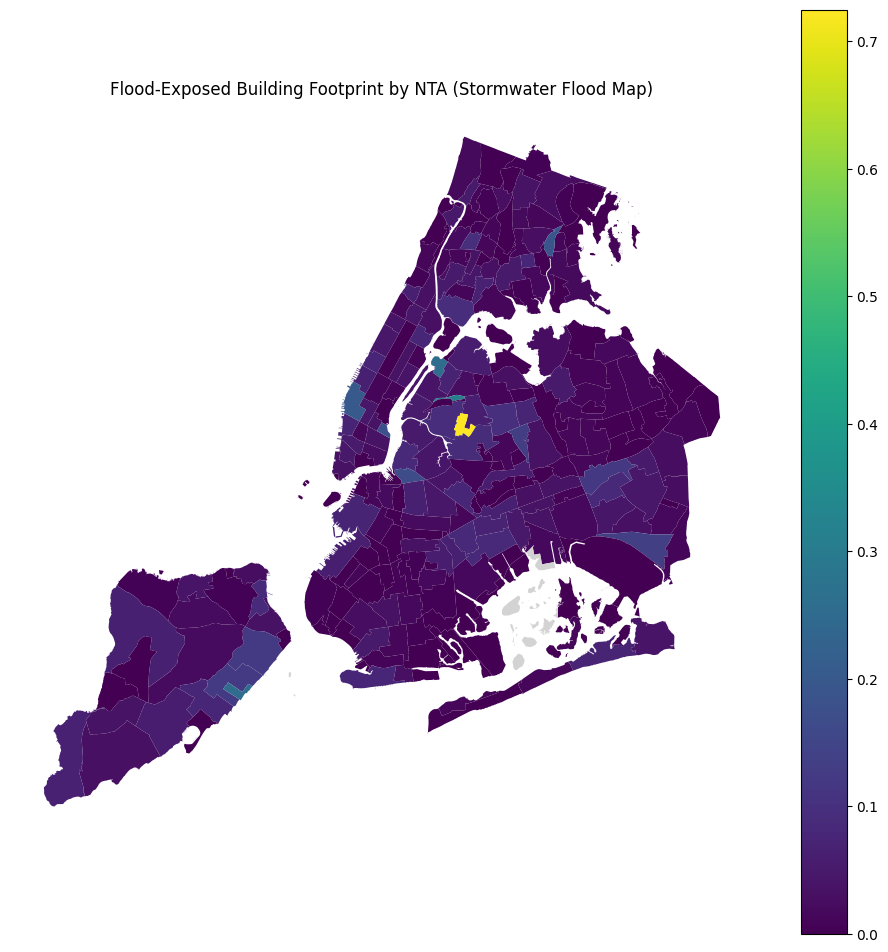

In [9]:
plot_choropleth(
    nta_viz,
    "pct_footprint_flooded",
    "Flood-Exposed Building Footprint by NTA (Stormwater Flood Map)"
)

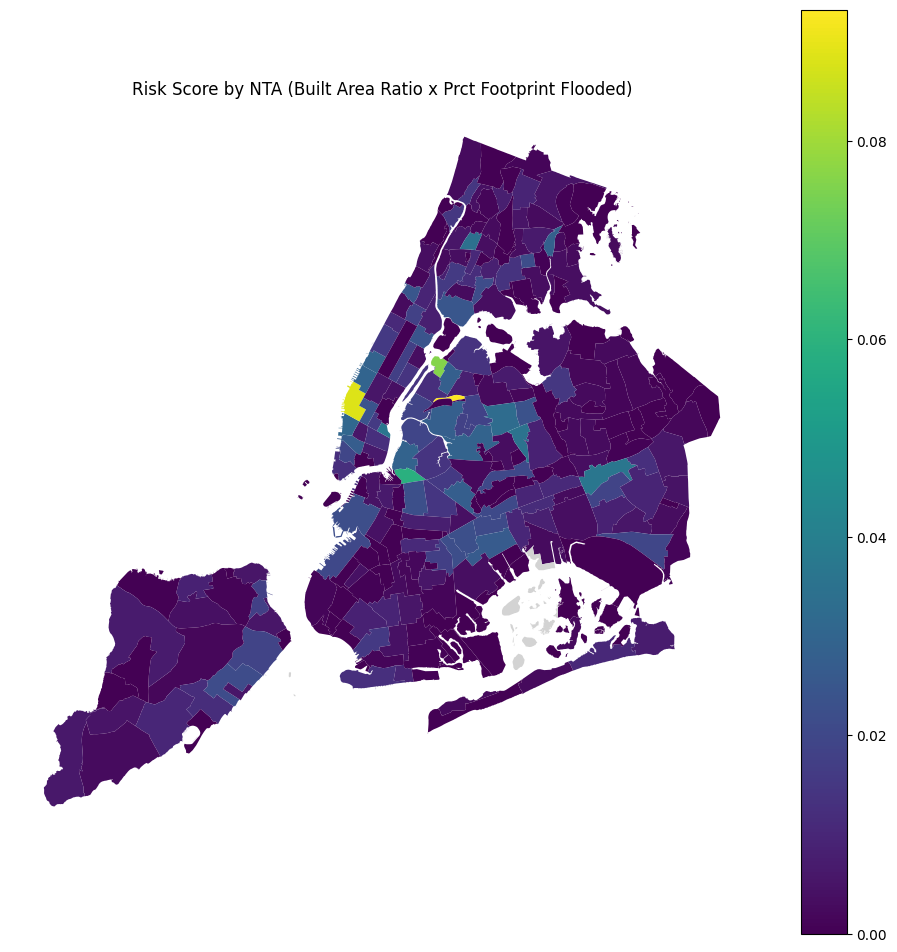

In [10]:
plot_choropleth(
    nta_viz,
    "risk_score",
    "Risk Score by NTA (Built Area Ratio x Prct Footprint Flooded)"
)

In [11]:
cols = ["NTACode","NTAName","boroname","built_area_ratio","pct_footprint_flooded","risk_score"]
nta_viz[cols].sort_values("risk_score", ascending=False).head(20)

,NTACode,NTAName,boroname,built_area_ratio,pct_footprint_flooded,risk_score
162,QN0161,Sunnyside Yards (North),Queens,0.301443,0.309469,0.093287
127,MN0401,Chelsea-Hudson Yards,Manhattan,0.444458,0.198664,0.088298
157,QN0102,Old Astoria-Hallets Point,Queens,0.294674,0.257414,0.075853
2,BK0103,South Williamsburg,Brooklyn,0.356268,0.166246,0.059228
215,QN1201,Jamaica,Queens,0.313400,0.116817,0.036610
131,MN0601,Stuyvesant Town-Peter Cooper Village,Manhattan,0.205679,0.177853,0.036581
183,QN0601,Rego Park,Queens,0.275499,0.129549,0.035691
84,BX0502,Mount Hope,Bronx,0.351019,0.097271,0.034144
173,QN0401,Elmhurst,Queens,0.328939,0.098904,0.032533
123,MN0203,West Village,Manhattan,0.416286,0.073578,0.030630


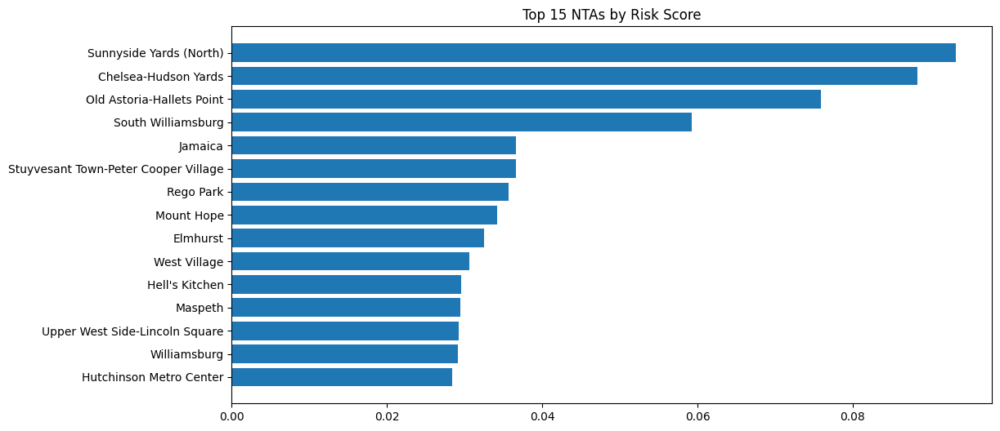

In [12]:
top = nta_viz[cols].sort_values("risk_score", ascending=False).head(15).copy()

plt.figure(figsize=(12,6))
plt.barh(top["NTAName"], top["risk_score"])
plt.title("Top 15 NTAs by Risk Score")
plt.gca().invert_yaxis()
plt.show()

In [13]:
borough_summary = (
    nta_viz.groupby("boroname")
           .agg(
               avg_risk=("risk_score","mean"),
               med_risk=("risk_score","median"),
               avg_built_ratio=("built_area_ratio","mean"),
               avg_flood_pct=("pct_footprint_flooded","mean"),
               nta_count=("NTACode","count")
           )
           .sort_values("avg_risk", ascending=False)
)

borough_summary

,avg_risk,med_risk,avg_built_ratio,avg_flood_pct,nta_count
boroname,,,,,
Manhattan,0.013563,0.010056,0.334825,0.036118,38
Queens,0.008882,0.002580,0.191468,0.040569,82
Brooklyn,0.007555,0.002262,0.257159,0.023506,69
Bronx,0.005960,0.002903,0.212835,0.022863,50
Staten Island,0.005942,0.005087,0.115797,0.048202,23


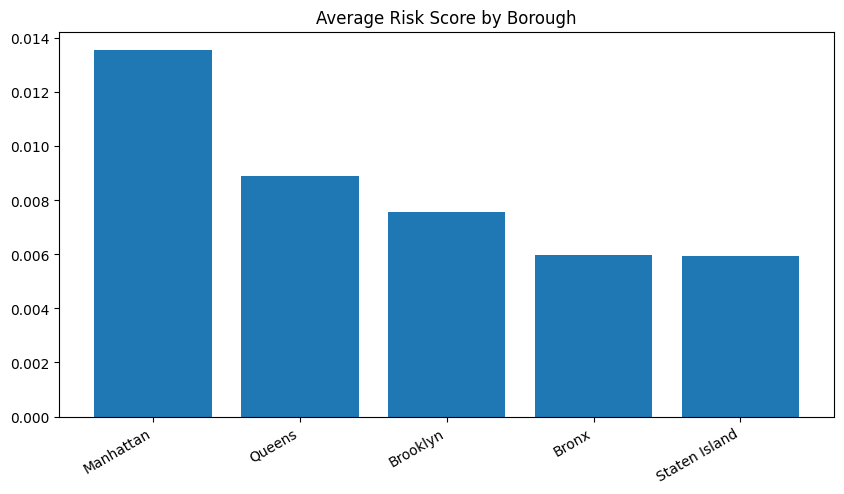

In [14]:
plt.figure(figsize=(10,5))
plt.bar(borough_summary.index, borough_summary["avg_risk"])
plt.title("Average Risk Score by Borough")
plt.xticks(rotation=30, ha="right")
plt.show()

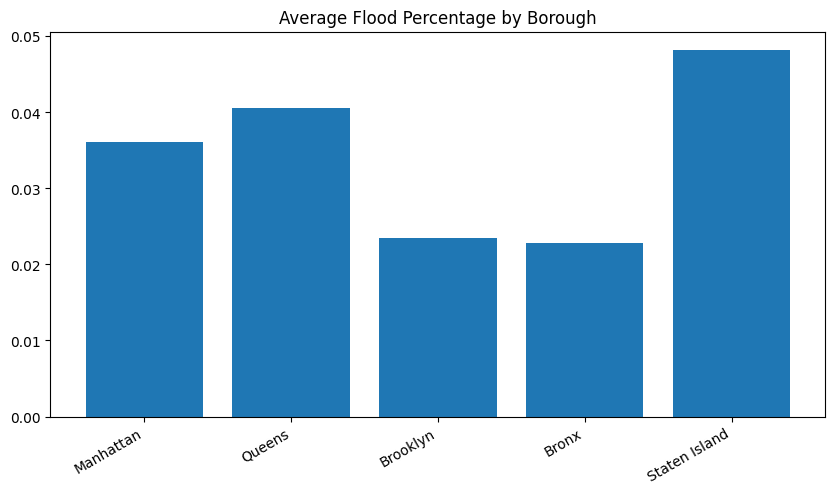

In [15]:
plt.figure(figsize=(10,5))
plt.bar(borough_summary.index, borough_summary["avg_flood_pct"])
plt.title("Average Flood Percentage by Borough")
plt.xticks(rotation=30, ha="right")
plt.show()

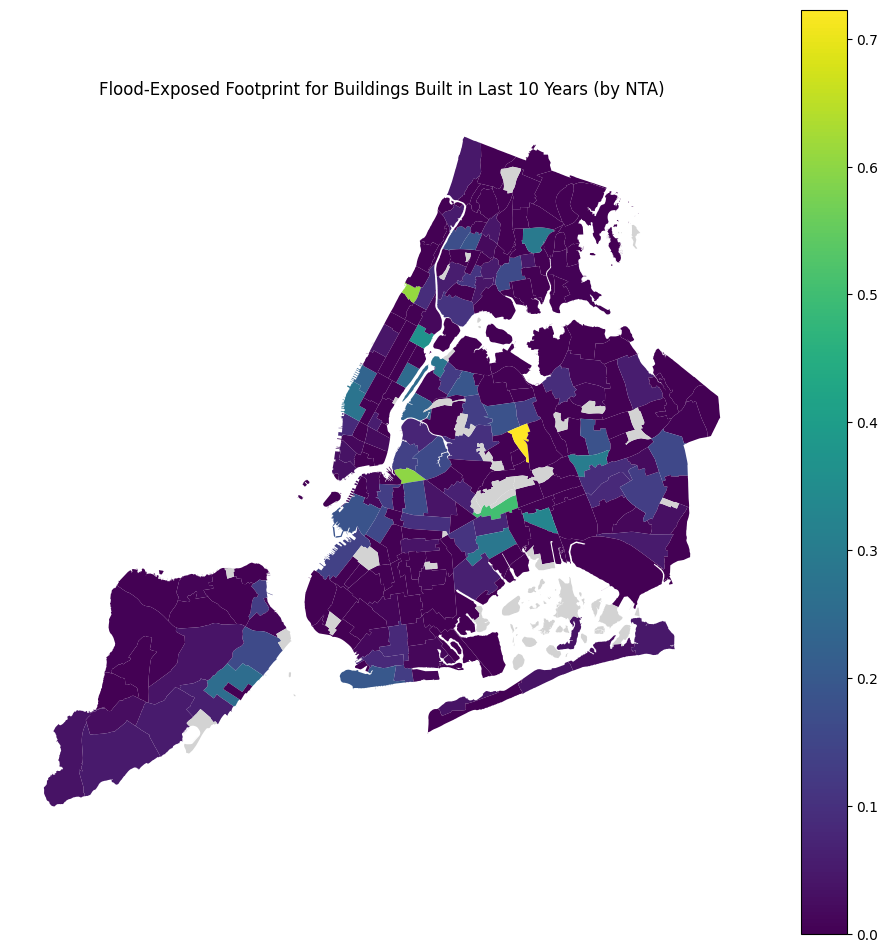

In [16]:
plot_choropleth(
        nta_viz,
        "pct_sqft_flooded_last10",
        "Flood-Exposed Footprint for Buildings Built in Last 10 Years (by NTA)"
)

In [17]:
import folium
from folium.features import GeoJsonTooltip

In [18]:
nta_wgs = nta_viz.to_crs(4326)

bld_pts = bld_viz.copy()
bld_pts["geometry"] = bld_pts.geometry.centroid
bld_pts = bld_pts.set_geometry("geometry").to_crs(4326)

# confirm buildings
print(bld_pts.shape)

(1082999, 11)


In [ ]:
import branca.colormap as cm

# get data range for colormap
risk_min = nta_wgs["risk_score"].min()
risk_max = nta_wgs["risk_score"].max()

# Yellow orange red for classic color scalre
colormap = cm.linear.YlOrRd_09.scale(risk_min, risk_max)
colormap.caption = "NTA Flood Risk Score"

In [20]:
# Define the style for folium, making it so that if risk_score has a value,
# we follow the colormap, else we make it grey
def style_fn(feature):
    risk = feature["properties"].get("risk_score")
    return {
        "fillColor": colormap(risk) if risk is not None else "#cccccc",
        "color": "black",
        "weight": 0.4,
        "fillOpacity": 0.7,
    }

In [21]:
m = folium.Map(
    location=[40.72, -73.95],
    zoom_start=11,
    tiles="cartodbpositron"
)

folium.GeoJson(
    nta_wgs,
    name="NTA Flood Risk",
    style_function=style_fn,
    tooltip=GeoJsonTooltip(
        fields=[
            "NTACode",
            "NTAName",
            "boroname",
            "built_area_ratio",
            "pct_footprint_flooded",
            "risk_score",
        ],
        aliases=[
            "NTA Code",
            "NTA Name",
            "Borough",
            "Built Area Ratio",
            "Flooded Footprint %",
            "Risk Score",
        ],
        localize=True,
    ),
).add_to(m)

colormap.add_to(m)

folium.LayerControl().add_to(m)

m


In [30]:
MAPS_DIR = os.path.join("..", "docs", "maps")
os.makedirs(MAPS_DIR, exist_ok=True)

map_path = os.path.join(MAPS_DIR, "nyc_flood_risk_ nta.html")
m.save(map_path)

In [31]:
stormwater = gpd.read_parquet(
    os.path.join(DATA_PROCESSED, "stormwater_2263.parquet")
)

In [ ]:
# CRS sanity check
print(stormwater.crs)

{"$schema": "https://proj.org/schemas/v0.7/projjson.schema.json", "type": "ProjectedCRS", "name": "NAD83 / New York Long Island (ftUS)", "base_crs": {"name": "NAD83", "datum": {"type": "GeodeticReferenceFrame", "name": "North American Datum 1983", "ellipsoid": {"name": "GRS 1980", "semi_major_axis": 6378137, "inverse_flattening": 298.257222101}}, "coordinate_system": {"subtype": "ellipsoidal", "axis": [{"name": "Geodetic latitude", "abbreviation": "Lat", "direction": "north", "unit": "degree"}, {"name": "Geodetic longitude", "abbreviation": "Lon", "direction": "east", "unit": "degree"}]}, "id": {"authority": "EPSG", "code": 4269}}, "conversion": {"name": "SPCS83 New York Long Island zone (US survey foot)", "method": {"name": "Lambert Conic Conformal (2SP)", "id": {"authority": "EPSG", "code": 9802}}, "parameters": [{"name": "Latitude of false origin", "value": 40.1666666666667, "unit": "degree", "id": {"authority": "EPSG", "code": 8821}}, {"name": "Longitude of false origin", "value": 

In [33]:
# merge both categories into one geometry
flood_geom = stormwater.geometry.union_all()



In [34]:
stormwater["Flooding_Category"].value_counts()


Flooding_Category
1    1
2    1
Name: count, dtype: int64

In [35]:
flooded = bld_pts[bld_pts["is_flooded"]]

In [36]:
print(len(flooded))

21514


In [ ]:
import numpy as np
import pandas as pd
import folium
import branca.colormap as cm

# can adjust if having performance issues
N_FLOODED = 100000
if len(flooded) > N_FLOODED:
    flooded = flooded.sample(N_FLOODED, random_state=42)

# colormap based on flooded footprint
vals = flooded["flooded_footprint_sqft"].fillna(0)
vmin = float(np.percentile(vals, 5))
vmax = float(np.percentile(vals, 95))
if vmax <= vmin:
    vmin, vmax = float(vals.min()), float(vals.max() if vals.max() > 0 else 1.0)

cmap = cm.LinearColormap(
    colors=["#4da3ff", "#ffe066", "#ff5c5c"],
    vmin=vmin, vmax=vmax,
)
cmap.caption = "Building Flooded Footprint (sqft) — sampled"

m = folium.Map(location=[40.72, -73.96], zoom_start=11, tiles="OpenStreetMap")

folium.GeoJson(
    nta_wgs,
    name="NTA boundaries",
    style_function=lambda x: {"fillOpacity": 0.0, "color": "black", "weight": 0.6},
).add_to(m)

flood_layer = folium.FeatureGroup(name="Flooded buildings", show=True)

for _, r in flooded.iterrows():
    if r.geometry is None or r.geometry.is_empty:
        continue

    v = float(r.get("flooded_footprint_sqft", 0) or 0)
    color = cmap(v)

    yr = r.get("construction_year")
    # fails without na handling
    yr_txt = int(yr) if pd.notna(yr) else "Unknown"

    folium.CircleMarker(
        location=[r.geometry.y, r.geometry.x],
        radius=2,
        color=color,
        fill=True,
        fill_color=color,
        fill_opacity=0.9,
        weight=0,
        popup=folium.Popup(
            f"""
            <b>ObjectID:</b> {r.get('objectid')}<br>
            <b>Construction Year:</b> {yr_txt}<br>
            <b>NTA Name:</b> {r.get('NTAName')}<br>
            <b>Borough:</b> {r.get('boroname')}<br>
            <b>Flooded sqft:</b> {v:,.0f}<br>
            """,
            max_width=300,
        ),
    ).add_to(flood_layer)

flood_layer.add_to(m)
cmap.add_to(m)
folium.LayerControl(collapsed=False).add_to(m)

m


In [41]:
top_risk = nta_viz[cols].sort_values("risk_score", ascending=False).head(50)
top_risk.to_csv(os.path.join(DATA_PROCESSED, "top_risk_nta.csv"), index=False)


In [42]:
MAPS_DIR = os.path.join("..", "docs", "maps")
os.makedirs(MAPS_DIR, exist_ok=True)

map_path = os.path.join(MAPS_DIR, "nyc_flood_risk_buildings.html")
m.save(map_path)